In [1]:
import tensorflow as tf
import os
import stat
import random
import shutil
import cv2
import imghdr
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import load_img, img_to_array,ImageDataGenerator
from tensorflow.keras.utils import to_categorical

In [2]:
data_dir = 'tensorflow_datasets/DATA/'
train_dir = os.path.join(data_dir, 'train')
test_dir = os.path.join(data_dir, 'testing')

In [3]:
# Daftar nama kelas (nama folder)
class_names = os.listdir(train_dir)

# Membuat direktori untuk data latih dan data validasi
training_dir = 'path/to/train_directory'
validation_dir = 'path/to/valid_directory'
os.makedirs(training_dir, exist_ok=True)
os.makedirs(validation_dir, exist_ok=True)

# Pembagian data dengan rasio 80:20
for class_name in class_names:
    class_dir = os.path.join(train_dir, class_name)
    images = os.listdir(class_dir)
    random.shuffle(images)
    split_index = int(0.8 * len(images))
    
    training_images = images[:split_index]
    validation_images = images[split_index:]
    
    for image in training_images:
        src = os.path.join(class_dir, image)
        dst = os.path.join(training_dir, class_name, image)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)
        
    for image in validation_images:
        src = os.path.join(class_dir, image)
        dst = os.path.join(validation_dir, class_name, image)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)

In [4]:
# Menampilkan isi folder train
print('Isi folder train:')
for class_name in os.listdir(training_dir):
    class_dir = os.path.join(training_dir, class_name)
    print(f'Kelas: {class_name}, Jumlah gambar: {len(os.listdir(class_dir))}')

# Menampilkan isi folder validation
print('Isi folder validation:')
for class_name in os.listdir(validation_dir):
    class_dir = os.path.join(validation_dir, class_name)
    print(f'Kelas: {class_name}, Jumlah gambar: {len(os.listdir(class_dir))}')

Isi folder train:
Kelas: Acne, Jumlah gambar: 70
Kelas: Actinic Keratosis, Jumlah gambar: 70
Kelas: Basal Cell Carcinoma, Jumlah gambar: 70
Kelas: Eczemaa, Jumlah gambar: 70
Kelas: Rosacea, Jumlah gambar: 70
Isi folder validation:
Kelas: Acne, Jumlah gambar: 18
Kelas: Actinic Keratosis, Jumlah gambar: 18
Kelas: Basal Cell Carcinoma, Jumlah gambar: 18
Kelas: Eczemaa, Jumlah gambar: 18
Kelas: Rosacea, Jumlah gambar: 18


TRAIN DAN VALIDATION

In [5]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
datagen = ImageDataGenerator(rescale=1.0/255.0)

# Definisikan objek ImageDataGenerator untuk normalisasi gambar
datagen_augmented = ImageDataGenerator(rescale=1.0/255.0,
                            rotation_range=40,  # Rentang rotasi antara -20 hingga +20 derajat
                            width_shift_range=0.2,  # Rentang pergeseran horizontal
                            height_shift_range=0.2,  # Rentang pergeseran vertikal
                            shear_range=0.2,  # Rentang pergeseran shear
                            zoom_range=0.2,  # Rentang perbesaran atau perkecilan
                            horizontal_flip=True,  # Flip horizontal
                            fill_mode='nearest')

# Buat dataset dari direktori menggunakan ImageDataGenerator
train_augmented_generator = datagen_augmented.flow_from_directory(
    training_dir,
    target_size=(128, 128),
    batch_size=32,
    class_mode='categorical',  # Klasifikasi multiclass
    shuffle=True
)
valid_augmented_generator = datagen_augmented.flow_from_directory(
    validation_dir,
    target_size=(128, 128),
    batch_size=32,
    class_mode='categorical',  # Klasifikasi multiclass
    shuffle=True
)

Found 350 images belonging to 5 classes.
Found 90 images belonging to 5 classes.


In [6]:
def create_model():
    model = Sequential()

    model.add(Conv2D(32, (3, 3), strides=1, activation="relu", input_shape=(128, 128, 3)))
    model.add(MaxPooling2D((2, 2)))

    model.add(Conv2D(64, (3, 3), strides=1, activation="relu"))
    model.add(MaxPooling2D((2, 2)))

    model.add(Conv2D(128, (3, 3), strides=1, activation="relu"))
    model.add(MaxPooling2D((2, 2)))

    model.add(Flatten())
    model.add(Dense(512, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(5, activation='softmax'))
    
    model.compile(
    loss='categorical_crossentropy',
    optimizer='adam',
    metrics=['accuracy']
)
    return model

In [7]:
# model = create_model()
model_augmented = create_model()

In [8]:
model_augmented.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 28, 28, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 14, 14, 128)      0

In [10]:
# dengan augmentasi
history_augmented = model_augmented.fit(
    train_augmented_generator,
    validation_data=(valid_augmented_generator),
    epochs=20,
    batch_size=32,
    steps_per_epoch=len(train_augmented_generator),
    validation_steps=len(valid_augmented_generator)
)

Epoch 1/20
11/11 [==============================] - 12s 1s/step - loss: 1.5926 - accuracy: 0.2486 - val_loss: 1.5433 - val_accuracy: 0.2889
Epoch 2/20
11/11 [==============================] - 12s 1s/step - loss: 1.5491 - accuracy: 0.2971 - val_loss: 1.4888 - val_accuracy: 0.3333
Epoch 3/20
11/11 [==============================] - 12s 1s/step - loss: 1.5350 - accuracy: 0.2800 - val_loss: 1.4482 - val_accuracy: 0.3111
Epoch 4/20
11/11 [==============================] - 12s 1s/step - loss: 1.4907 - accuracy: 0.2714 - val_loss: 1.4138 - val_accuracy: 0.3222
Epoch 5/20
11/11 [==============================] - 12s 1s/step - loss: 1.4630 - accuracy: 0.3114 - val_loss: 1.4028 - val_accuracy: 0.3444
Epoch 6/20
11/11 [==============================] - 12s 1s/step - loss: 1.4685 - accuracy: 0.3314 - val_loss: 1.3829 - val_accuracy: 0.3444
Epoch 7/20
11/11 [==============================] - 12s 1s/step - loss: 1.4410 - accuracy: 0.3000 - val_loss: 1.3664 - val_accuracy: 0.3778
Epoch 8/20
11/11 [==

In [11]:
datagen = ImageDataGenerator(rescale=1.0/255.0)

test_augmented_generator = datagen.flow_from_directory(
    test_dir,
    target_size=(128, 128),
    batch_size=32,
    class_mode='categorical',  # Klasifikasi multiclass
    shuffle=True
)

Found 185 images belonging to 5 classes.


In [12]:
model_augmented.evaluate(test_augmented_generator)

6/6 [==============================] - 2s 301ms/step - loss: 1.5692 - accuracy: 0.2973


[1.5691527128219604, 0.29729729890823364]

In [13]:
# # Memperoleh data untuk plot
# train_acc = history.history['accuracy']
# val_acc = history.history['val_accuracy']
# train_loss = history.history['loss']
# val_loss = history.history['val_loss']

train_acc_augmented = history_augmented.history['accuracy']
val_acc_augmented = history_augmented.history['val_accuracy']
train_loss_augmented = history_augmented.history['loss']
val_loss_augmented = history_augmented.history['val_loss']

epochs = range(1, len(train_acc_augmented)+1)

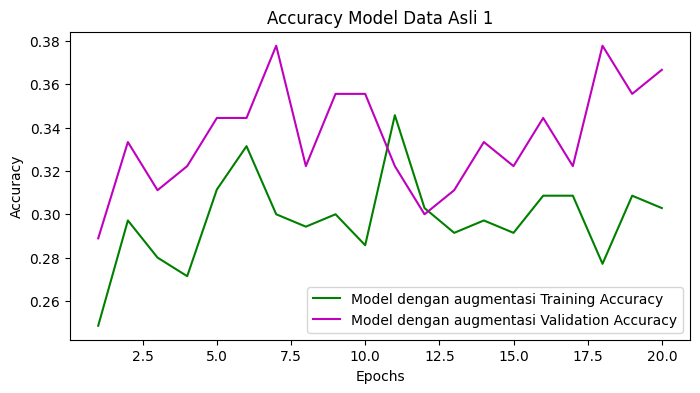

In [14]:
# # Melakukan plotting untuk akurasi Model 1
# plt.figure(figsize=(8, 4))
# plt.plot(epochs, train_acc, 'r', label='Model tanpa augmentasi Training Accuracy')
# plt.plot(epochs, val_acc, 'b', label='Model tanpa augmentasi Validation Accuracy')
# plt.title('Model tanpa augmentasi Training and Validation Accuracy')
# plt.xlabel('Epochs')
# plt.ylabel('Accuracy')
# plt.legend()
# plt.show()

# Melakukan plotting untuk akurasi Model 2
plt.figure(figsize=(8, 4))
plt.plot(epochs, train_acc_augmented, 'g', label='Model dengan augmentasi Training Accuracy')
plt.plot(epochs, val_acc_augmented, 'm', label='Model dengan augmentasi Validation Accuracy')
plt.title('Accuracy Model Data Asli 1')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

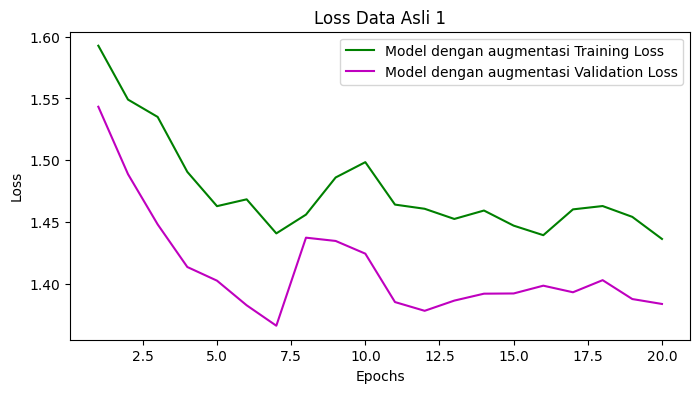

In [15]:
# # Melakukan plotting untuk akurasi Model 1
# plt.figure(figsize=(8, 4))
# plt.plot(epochs, train_loss, 'r', label='Model tanpa augmentasi Training Loss')
# plt.plot(epochs, val_loss, 'b', label='Model tanpa augmentasi Validation Loss')
# plt.title('Model tanpa augmentasi Training and Validation Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

# Melakukan plotting untuk akurasi Model 2
plt.figure(figsize=(8, 4))
plt.plot(epochs, train_loss_augmented, 'g', label='Model dengan augmentasi Training Loss')
plt.plot(epochs, val_loss_augmented, 'm', label='Model dengan augmentasi Validation Loss')
plt.title('Loss Data Asli 1')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [57]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

classs = ['Acne', 'Actinic Keratosis', 'Basal Cell Carcinoma', 'Eczema', 'Rosacea']

# Prediksi pada data validation
print('Testing Using 185 Images:')
predictions = model_augmented.predict(test_augmented_generator)

# Label sebenarnya dari generator
target = test_augmented_generator.labels

# Mengubah hasil prediksi menjadi bentuk kelas
predicted_classes = np.argmax(predictions, axis=1)

# Menghitung metrik individual
accuracy = accuracy_score(target, predicted_classes)
precision = precision_score(target, predicted_classes, average='macro', zero_division=1.0)
recall = recall_score(target, predicted_classes, average='macro')
f1 = f1_score(target, predicted_classes, average='macro')

# Menampilkan metrik
print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1-score: {f1}')

Testing Using 185 Images:
6/6 [==============================] - 2s 285ms/step
Accuracy: 0.21081081081081082
Precision: 0.22424963924963923
Recall: 0.21081081081081082
F1-score: 0.16678999511053513


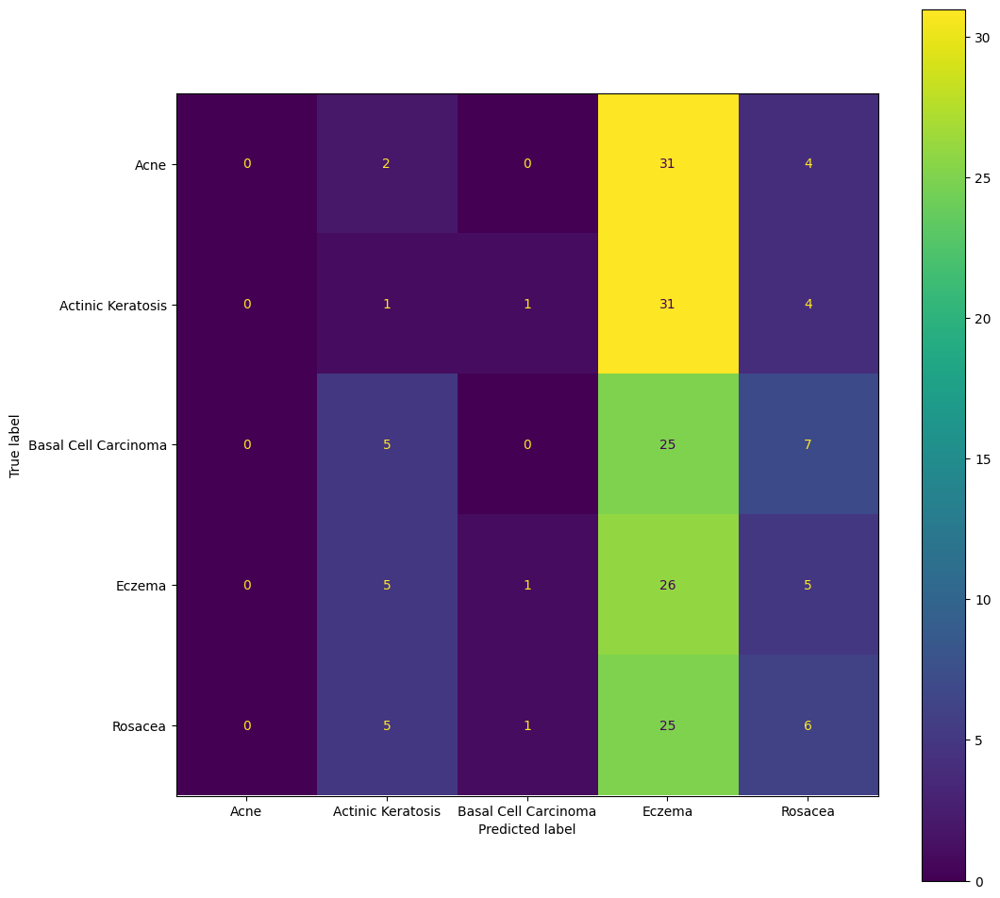

In [63]:
from sklearn.metrics import ConfusionMatrixDisplay

fig, ax = plt.subplots(figsize=(12,12))
ConfusionMatrixDisplay.from_predictions(target, predicted_classes,ax=ax ,display_labels = classs)
plt.show()

TEST DATA BARU

1/1 [==============================] - 0s 72ms/step


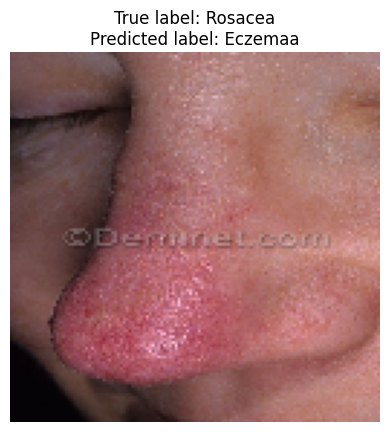

1/1 [==============================] - 0s 86ms/step


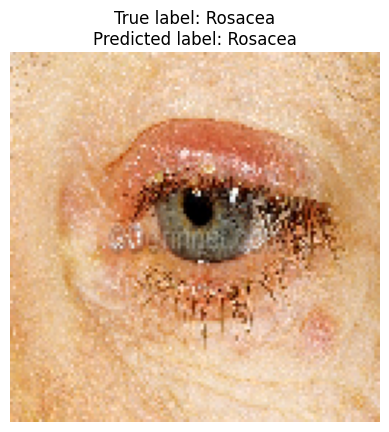

1/1 [==============================] - 0s 46ms/step


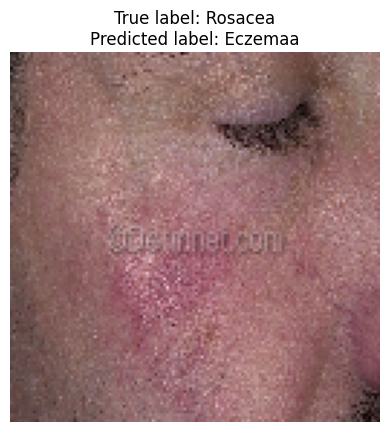

1/1 [==============================] - 0s 38ms/step


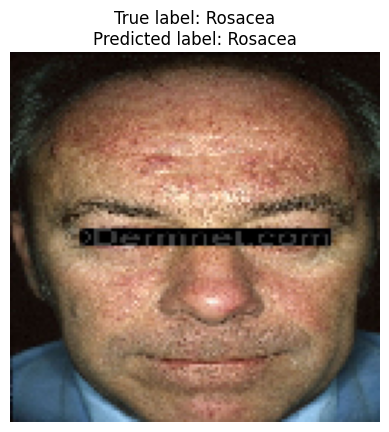

1/1 [==============================] - 0s 37ms/step


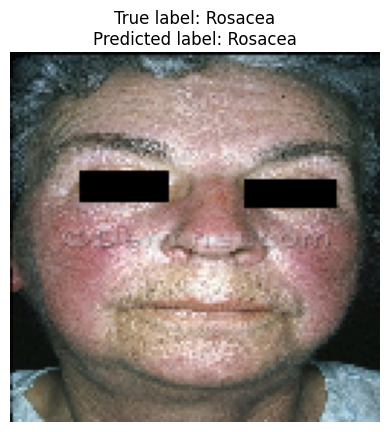

1/1 [==============================] - 0s 42ms/step


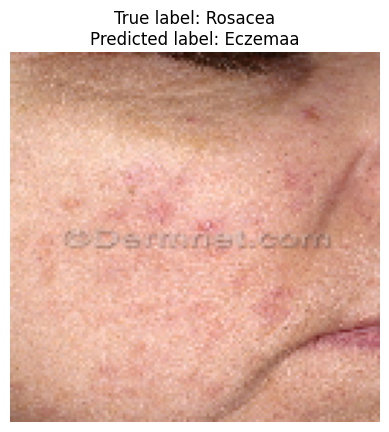

1/1 [==============================] - 0s 44ms/step


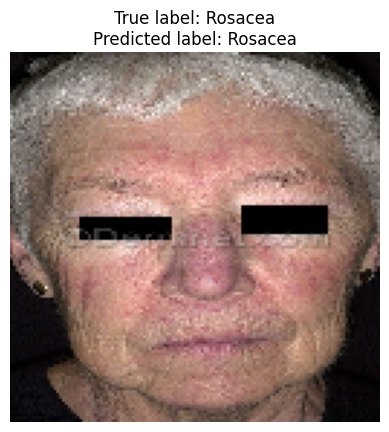

1/1 [==============================] - 0s 41ms/step


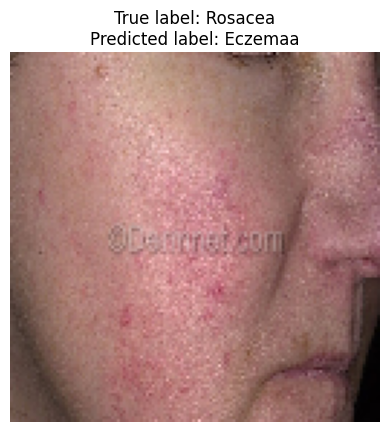

1/1 [==============================] - 0s 42ms/step


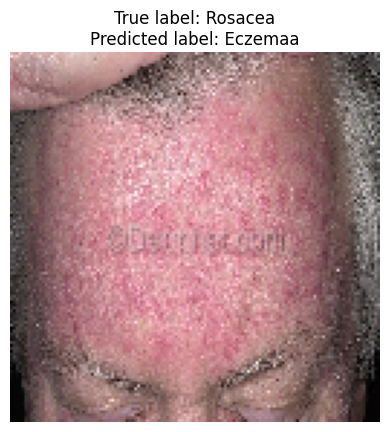

1/1 [==============================] - 0s 40ms/step


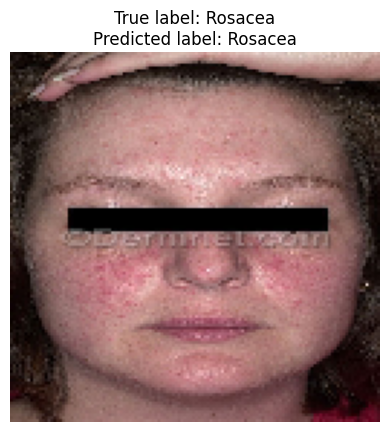

1/1 [==============================] - 0s 41ms/step


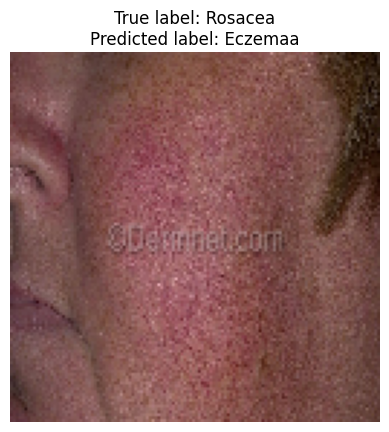

1/1 [==============================] - 0s 43ms/step


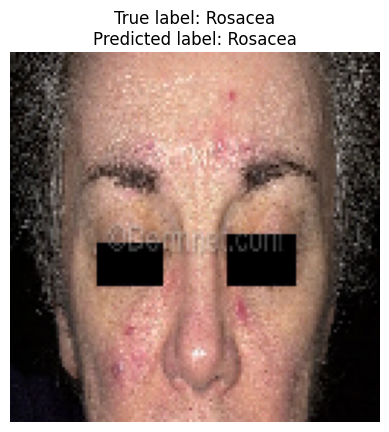

1/1 [==============================] - 0s 40ms/step


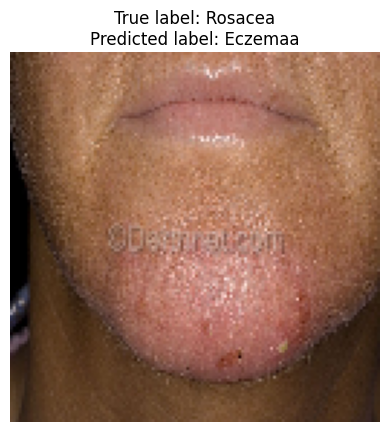

1/1 [==============================] - 0s 40ms/step


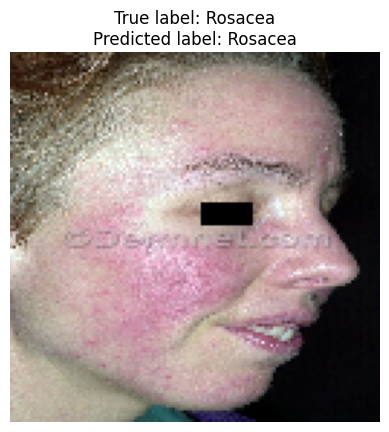

1/1 [==============================] - 0s 42ms/step


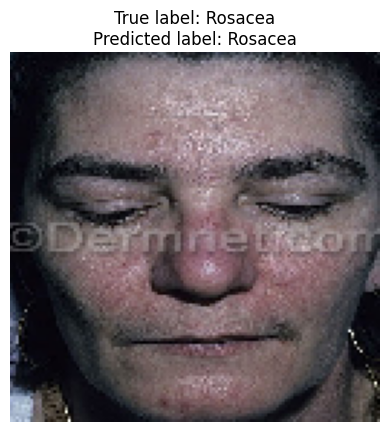

1/1 [==============================] - 0s 38ms/step


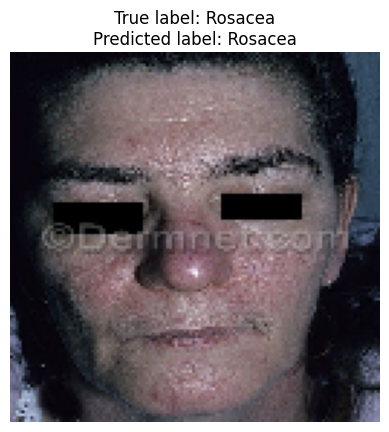

1/1 [==============================] - 0s 38ms/step


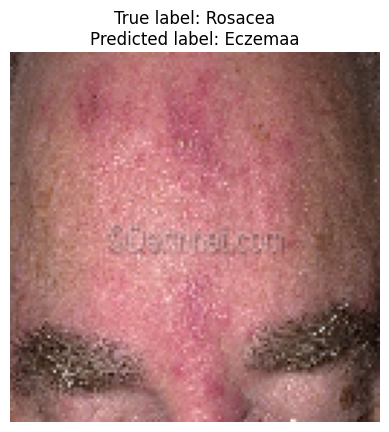

1/1 [==============================] - 0s 42ms/step


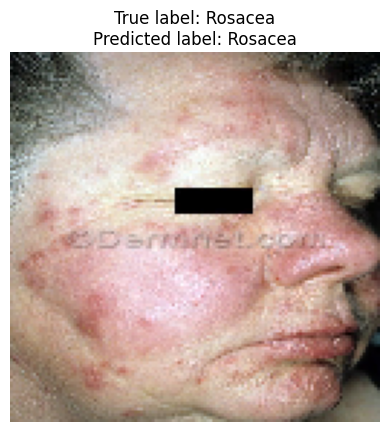

1/1 [==============================] - 0s 49ms/step


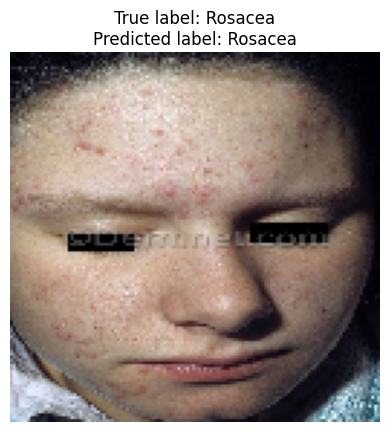

1/1 [==============================] - 0s 39ms/step


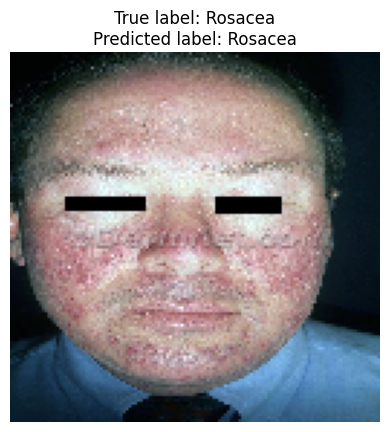

1/1 [==============================] - 0s 42ms/step


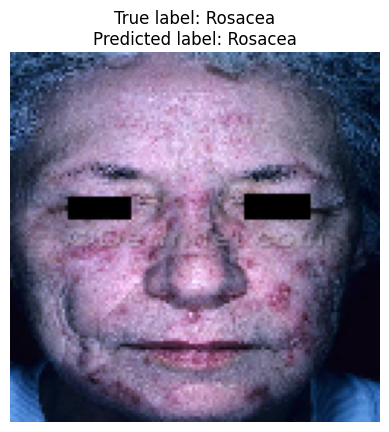

1/1 [==============================] - 0s 41ms/step


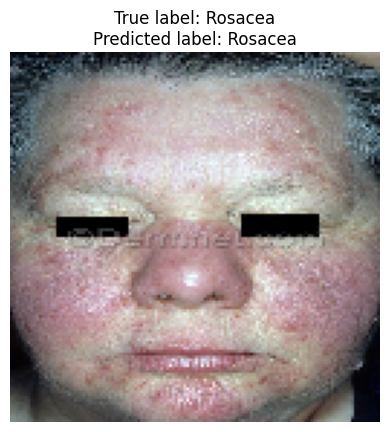

1/1 [==============================] - 0s 44ms/step


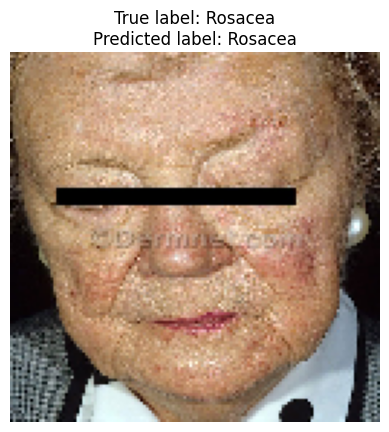

1/1 [==============================] - 0s 40ms/step


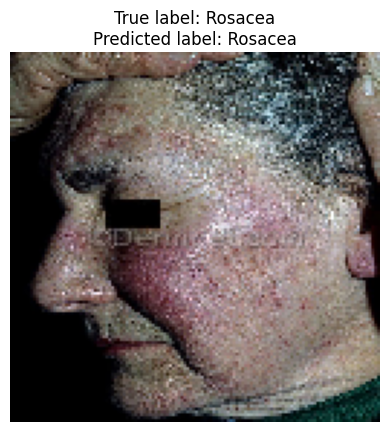

1/1 [==============================] - 0s 37ms/step


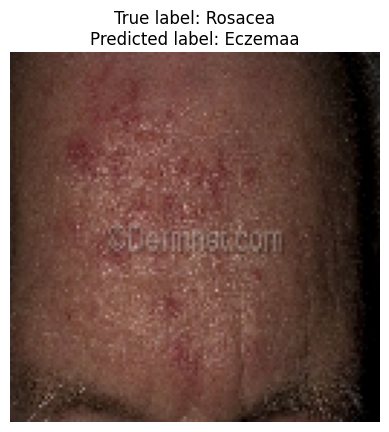

1/1 [==============================] - 0s 40ms/step


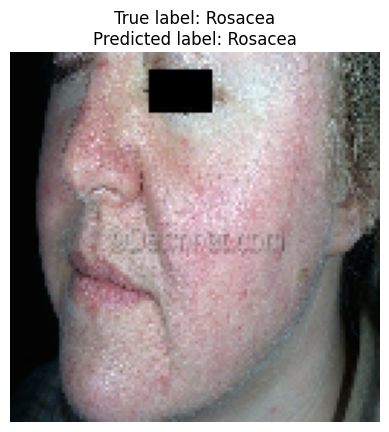

1/1 [==============================] - 0s 42ms/step


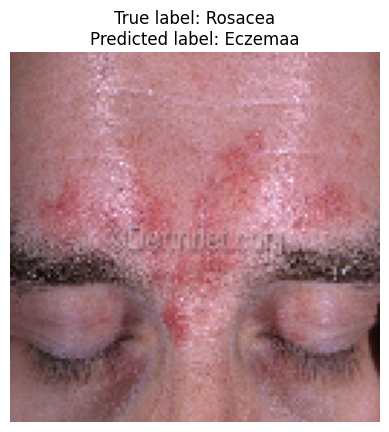

1/1 [==============================] - 0s 41ms/step


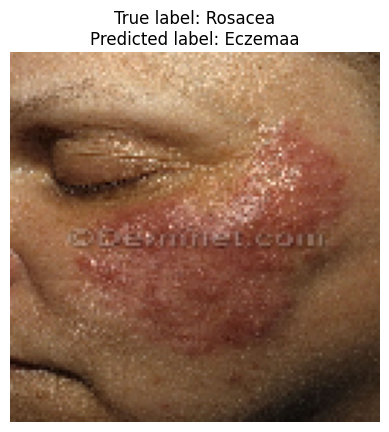

1/1 [==============================] - 0s 38ms/step


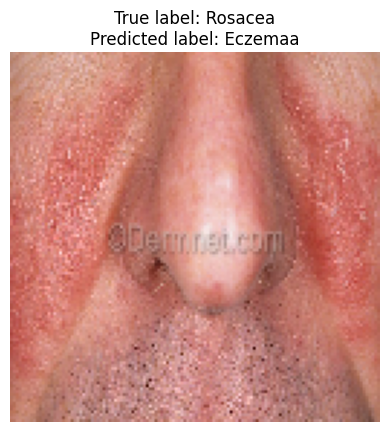

1/1 [==============================] - 0s 40ms/step


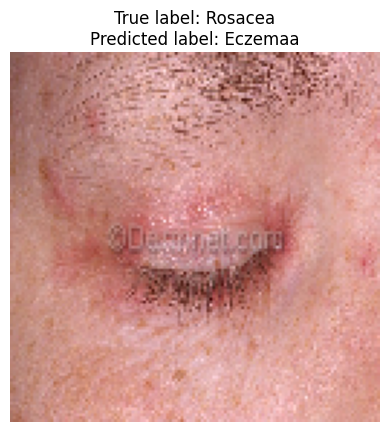

1/1 [==============================] - 0s 46ms/step


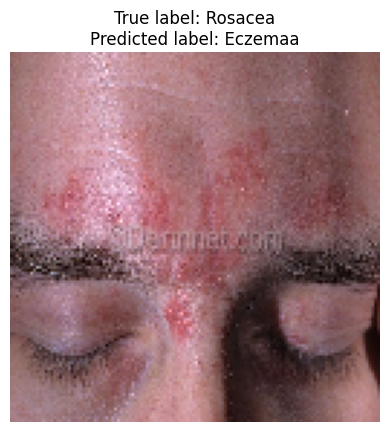

1/1 [==============================] - 0s 43ms/step


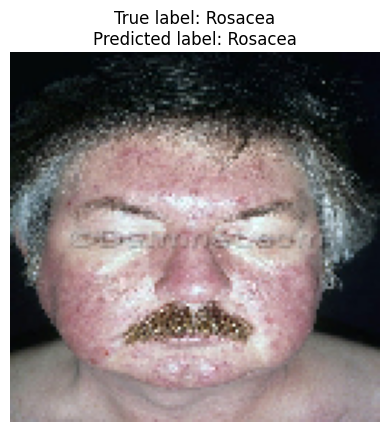

1/1 [==============================] - 0s 46ms/step


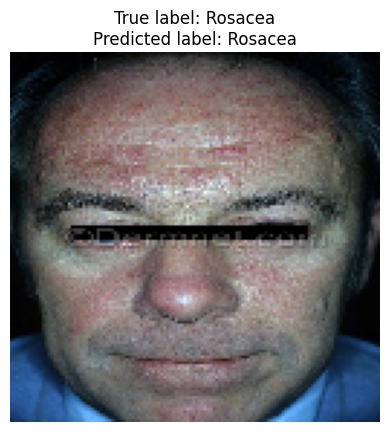

1/1 [==============================] - 0s 40ms/step


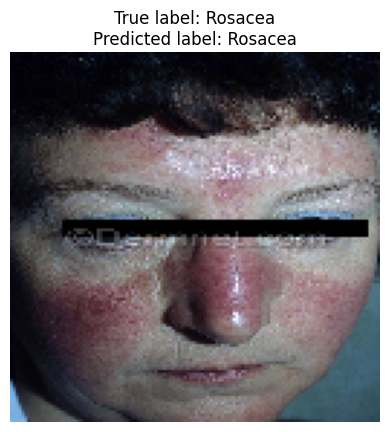

1/1 [==============================] - 0s 48ms/step


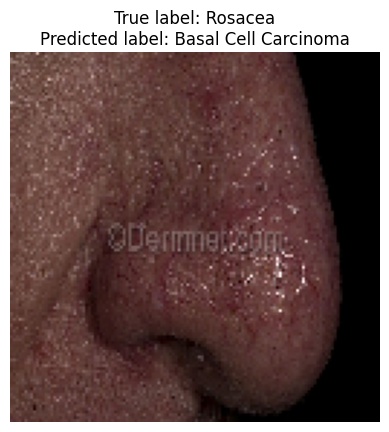

1/1 [==============================] - 0s 43ms/step


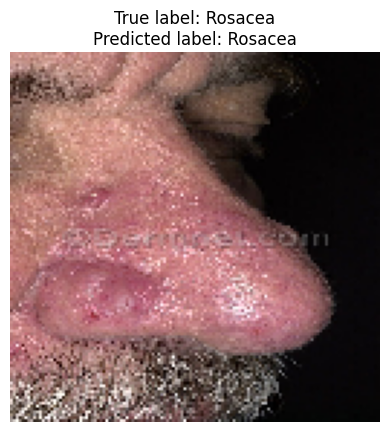

1/1 [==============================] - 0s 37ms/step


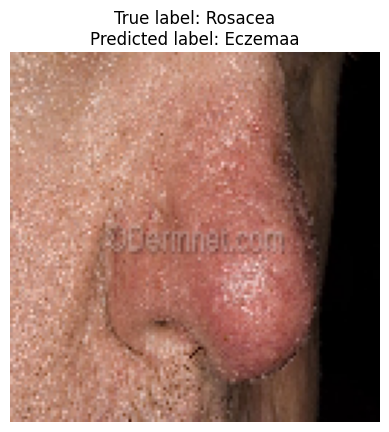

In [70]:
import os

# Path folder gambar
folder_path = 'tensorflow_datasets/DATA/Sample test/Rosacea'
# Map index to class name
class_names = os.listdir(test_dir)

# Loop melalui setiap file gambar dalam folder
for file_name in os.listdir(folder_path):
    # Path file gambar
    img_path = os.path.join(folder_path, file_name)
    # Load image
    img = load_img(img_path, target_size=(128, 128))
    imgplot = plt.imshow(img)
    true_label = class_names[4]
    img_array = img_to_array(img)
    batch_img = np.expand_dims(img_array, axis=0)
    # Make prediction
    prediction = model_augmented.predict(batch_img)
    # Get the predicted class index
    predicted_class_index = prediction.argmax(axis=-1)[0]
    predicted_class_name = class_names[predicted_class_index]

    # Plot image with true and predicted labels
    plt.imshow(img_array.astype(np.uint8))
    plt.title(f'True label: {true_label}\nPredicted label: {predicted_class_name}')
    plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 40ms/step


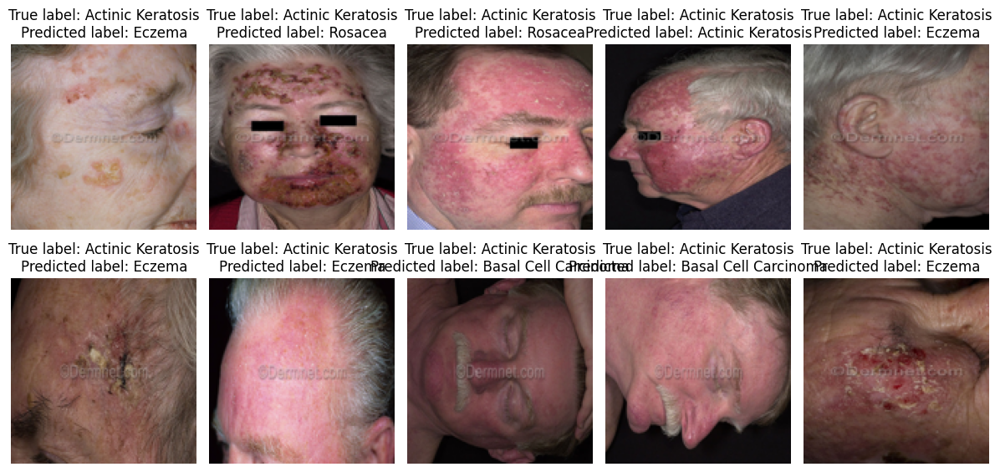

In [86]:
import matplotlib.pyplot as plt
from PIL import Image

# Path folder gambar
folder_path = 'tensorflow_datasets/DATA/Sample test/Actinic Keratosis'
# Map index to class name
class_names = ['Acne', 'Actinic Keratosis', 'Basal Cell Carcinoma', 'Eczema', 'Rosacea']  # Sesuaikan dengan kelas yang digunakan dalam pelatihan model

# Inisialisasi grid plot
fig, axes = plt.subplots(2, 5, figsize=(12, 6))

# Loop melalui setiap file gambar dalam folder
for i, file_name in enumerate(os.listdir(folder_path)):
    if i >= 10:
        break
    # Path file gambar
    img_path = os.path.join(folder_path, file_name)
    # Load image
    img = Image.open(img_path)
    true_label = class_names[1]
    img = img.resize((128, 128))  # Ubah ukuran gambar menjadi kecil
    img_array = np.array(img)
    batch_img = np.expand_dims(img_array, axis=0)
    # Make prediction
    prediction = model_augmented.predict(batch_img)
    # Get the predicted class index
    predicted_class_index = prediction.argmax(axis=-1)[0]
    predicted_class_name = class_names[predicted_class_index]

    # Plot gambar pada grid
    ax = axes[i // 5, i % 5]
    ax.imshow(img_array)
    ax.set_title(f'True label: {true_label}\nPredicted label: {predicted_class_name}')
    ax.axis('off')

# Tampilkan grid plot
plt.tight_layout()
plt.show()


SPLIT DATA 75:25

In [19]:
# Daftar nama kelas (nama folder)
class_names = os.listdir(train_dir)

# Membuat direktori untuk data latih dan data validasi
training_dir = 'path/to/train_directory75'
validation_dir = 'path/to/valid_directory25'
os.makedirs(training_dir, exist_ok=True)
os.makedirs(validation_dir, exist_ok=True)

# Pembagian data dengan rasio 75:25
for class_name in class_names:
    class_dir = os.path.join(train_dir, class_name)
    images = os.listdir(class_dir)
    random.shuffle(images)
    split_index = int(0.75 * len(images))
    
    training_images = images[:split_index]
    validation_images = images[split_index:]
    
    for image in training_images:
        src = os.path.join(class_dir, image)
        dst = os.path.join(training_dir, class_name, image)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)
        
    for image in validation_images:
        src = os.path.join(class_dir, image)
        dst = os.path.join(validation_dir, class_name, image)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)

In [20]:
# Menampilkan isi folder train
print('Isi folder train:')
for class_name in os.listdir(training_dir):
    class_dir = os.path.join(training_dir, class_name)
    print(f'Kelas: {class_name}, Jumlah gambar: {len(os.listdir(class_dir))}')

# Menampilkan isi folder validation
print('Isi folder validation:')
for class_name in os.listdir(validation_dir):
    class_dir = os.path.join(validation_dir, class_name)
    print(f'Kelas: {class_name}, Jumlah gambar: {len(os.listdir(class_dir))}')

Isi folder train:
Kelas: Acne, Jumlah gambar: 66
Kelas: Actinic Keratosis, Jumlah gambar: 66
Kelas: Basal Cell Carcinoma, Jumlah gambar: 66
Kelas: Eczemaa, Jumlah gambar: 66
Kelas: Rosacea, Jumlah gambar: 66
Isi folder validation:
Kelas: Acne, Jumlah gambar: 22
Kelas: Actinic Keratosis, Jumlah gambar: 22
Kelas: Basal Cell Carcinoma, Jumlah gambar: 22
Kelas: Eczemaa, Jumlah gambar: 22
Kelas: Rosacea, Jumlah gambar: 22


In [21]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Definisikan objek ImageDataGenerator untuk normalisasi gambar
datagen_augmented = ImageDataGenerator(rescale=1.0/255.0,
                            rotation_range=40,  # Rentang rotasi antara -20 hingga +20 derajat
                            width_shift_range=0.2,  # Rentang pergeseran horizontal
                            height_shift_range=0.2,  # Rentang pergeseran vertikal
                            shear_range=0.2,  # Rentang pergeseran shear
                            zoom_range=0.2,  # Rentang perbesaran atau perkecilan
                            horizontal_flip=True,  # Flip horizontal
                            fill_mode='nearest')

# Buat dataset dari direktori menggunakan ImageDataGenerator
train_augmented_generator = datagen_augmented.flow_from_directory(
    training_dir,
    target_size=(128, 128),
    batch_size=32,
    class_mode='categorical',  # Klasifikasi multiclass
    shuffle=True
)
valid_augmented_generator = datagen_augmented.flow_from_directory(
    validation_dir,
    target_size=(128, 128),
    batch_size=32,
    class_mode='categorical',  # Klasifikasi multiclass
    shuffle=True
)

Found 330 images belonging to 5 classes.
Found 110 images belonging to 5 classes.


In [22]:
# def create_model():
#     model = Sequential([
#     Conv2D(32, (3,3), 1, activation="relu", input_shape = (128, 128, 3)),
#     MaxPooling2D((2,2)),

#     Conv2D(16, (3,3), 1, activation="relu"),
#     MaxPooling2D((2,2)),
    
#     Conv2D(8, (3,3), 1, activation="relu"),
#     MaxPooling2D((2,2)),
    
#     Flatten(),
#     Dense(512, activation='relu'),
#     Dense(256, activation='relu'),
#     Dense(128, activation='relu'),
#     Dense(5, activation='softmax'),
# ])
#     model.compile(
#     loss='categorical_crossentropy',
#     optimizer='adam',
#     metrics=['accuracy']
# )
#     return model

In [23]:
# model = create_model()
model_augmented2 = create_model()

In [24]:
model_augmented2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 28, 28, 128)       73856     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 14, 14, 128)     

In [25]:
# dengan augmentasi
history_augmented = model_augmented2.fit(
    train_augmented_generator,
    validation_data=(valid_augmented_generator),
    epochs=20,
    batch_size=32,
    steps_per_epoch=len(train_augmented_generator),
    validation_steps=len(valid_augmented_generator)
)

Epoch 1/20
11/11 [==============================] - 17s 1s/step - loss: 1.6607 - accuracy: 0.1939 - val_loss: 1.6095 - val_accuracy: 0.2000
Epoch 2/20
11/11 [==============================] - 12s 1s/step - loss: 1.6142 - accuracy: 0.1515 - val_loss: 1.6081 - val_accuracy: 0.2091
Epoch 3/20
11/11 [==============================] - 12s 1s/step - loss: 1.6070 - accuracy: 0.2121 - val_loss: 1.6034 - val_accuracy: 0.2818
Epoch 4/20
11/11 [==============================] - 12s 1s/step - loss: 1.6012 - accuracy: 0.2333 - val_loss: 1.5930 - val_accuracy: 0.2909
Epoch 5/20
11/11 [==============================] - 13s 1s/step - loss: 1.5771 - accuracy: 0.2455 - val_loss: 1.5356 - val_accuracy: 0.3182
Epoch 6/20
11/11 [==============================] - 12s 1s/step - loss: 1.5481 - accuracy: 0.2970 - val_loss: 1.5224 - val_accuracy: 0.3182
Epoch 7/20
11/11 [==============================] - 12s 1s/step - loss: 1.5196 - accuracy: 0.3182 - val_loss: 1.5012 - val_accuracy: 0.3273
Epoch 8/20
11/11 [==

In [26]:
model_augmented2.evaluate(test_augmented_generator)

6/6 [==============================] - 2s 299ms/step - loss: 1.6054 - accuracy: 0.2703


[1.6053985357284546, 0.2702702581882477]

In [27]:
# # Memperoleh data untuk plot
# train_acc = history.history['accuracy']
# val_acc = history.history['val_accuracy']
# train_loss = history.history['loss']
# val_loss = history.history['val_loss']

train_acc_augmented = history_augmented.history['accuracy']
val_acc_augmented = history_augmented.history['val_accuracy']
train_loss_augmented = history_augmented.history['loss']
val_loss_augmented = history_augmented.history['val_loss']

epochs = range(1, len(train_acc_augmented)+1)

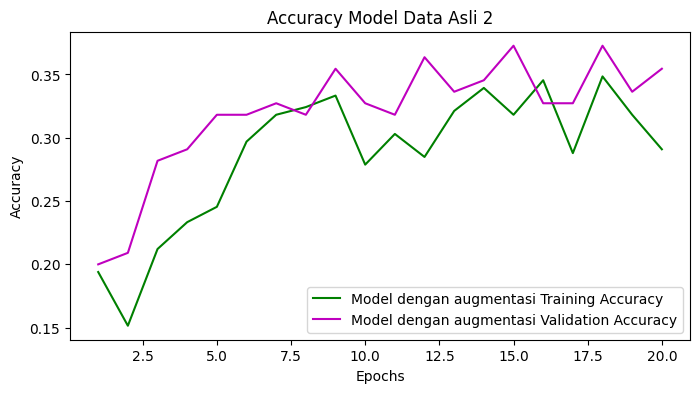

In [28]:
# # Melakukan plotting untuk akurasi Model 1
# plt.figure(figsize=(8, 4))
# plt.plot(epochs, train_acc, 'r', label='Model tanpa augmentasi Training Accuracy')
# plt.plot(epochs, val_acc, 'b', label='Model tanpa augmentasi Validation Accuracy')
# plt.title('Model tanpa augmentasi Training and Validation Accuracy')
# plt.xlabel('Epochs')
# plt.ylabel('Accuracy')
# plt.legend()
# plt.show()

# Melakukan plotting untuk akurasi Model 2
plt.figure(figsize=(8, 4))
plt.plot(epochs, train_acc_augmented, 'g', label='Model dengan augmentasi Training Accuracy')
plt.plot(epochs, val_acc_augmented, 'm', label='Model dengan augmentasi Validation Accuracy')
plt.title('Accuracy Model Data Asli 2')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

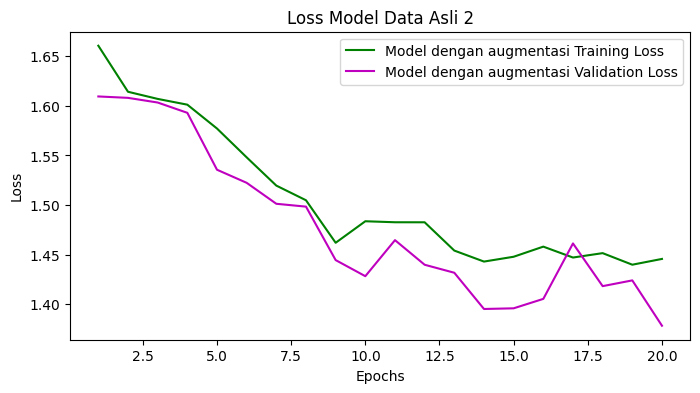

In [29]:
# # Melakukan plotting untuk akurasi Model 1
# plt.figure(figsize=(8, 4))
# plt.plot(epochs, train_loss, 'r', label='Model tanpa augmentasi Training Loss')
# plt.plot(epochs, val_loss, 'b', label='Model tanpa augmentasi Validation Loss')
# plt.title('Model tanpa augmentasi Training and Validation Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

# Melakukan plotting untuk akurasi Model 2
plt.figure(figsize=(8, 4))
plt.plot(epochs, train_loss_augmented, 'g', label='Model dengan augmentasi Training Loss')
plt.plot(epochs, val_loss_augmented, 'm', label='Model dengan augmentasi Validation Loss')
plt.title('Loss Model Data Asli 2')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [62]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

classs = ['Acne', 'Actinic Keratosis', 'Basal Cell Carcinoma', 'Eczema', 'Rosacea']

# Prediksi pada data validation
predictions = model_augmented2.predict(test_augmented_generator)

# Label sebenarnya dari generator
target = test_augmented_generator.labels

# Mengubah hasil prediksi menjadi bentuk kelas
predicted_classes = np.argmax(predictions, axis=1)

# Menghitung metrik individual
accuracy = accuracy_score(target, predicted_classes)
precision = precision_score(target, predicted_classes, average='macro')
recall = recall_score(target, predicted_classes, average='macro')
f1 = f1_score(target, predicted_classes, average='macro')

# Menampilkan metrik
print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1-score: {f1}')

6/6 [==============================] - 2s 273ms/step
Accuracy: 0.1783783783783784
Precision: 0.09494611668524713
Recall: 0.1783783783783784
F1-score: 0.1047965367965368


c:\users\yusuf\appdata\local\programs\python\python38\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


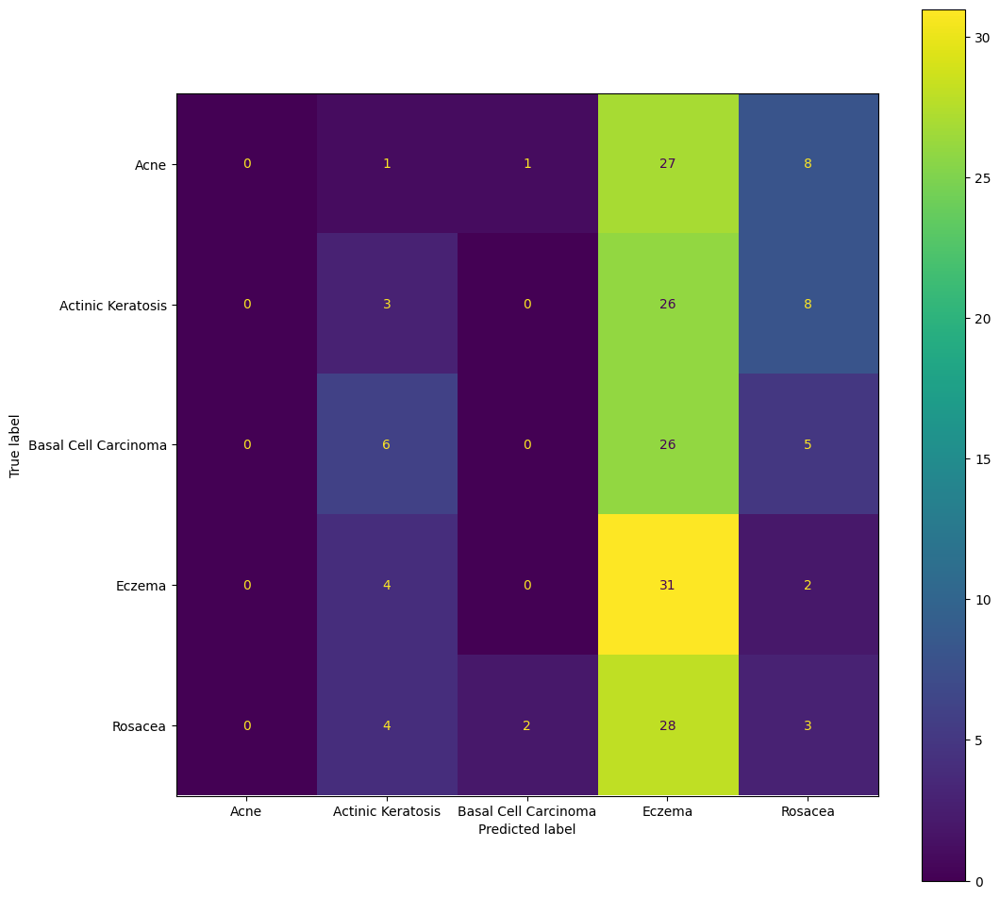

In [53]:
from sklearn.metrics import ConfusionMatrixDisplay

fig, ax = plt.subplots(figsize=(12,12))
ConfusionMatrixDisplay.from_predictions(target, predicted_classes,ax=ax ,display_labels = classs)
plt.show()

1/1 [==============================] - 0s 47ms/step


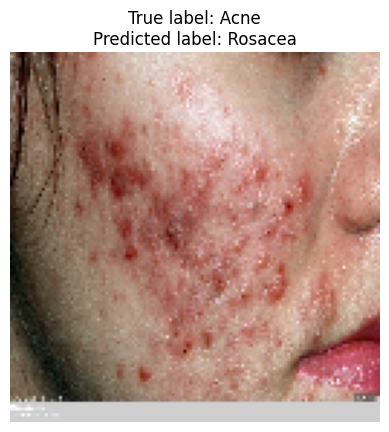

1/1 [==============================] - 0s 46ms/step


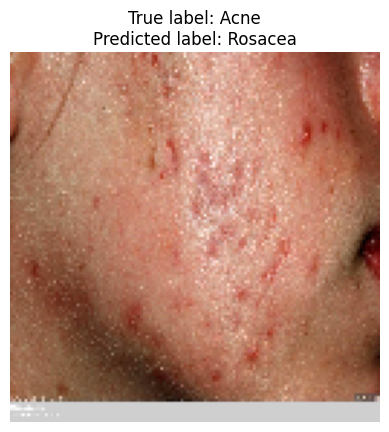

1/1 [==============================] - 0s 40ms/step


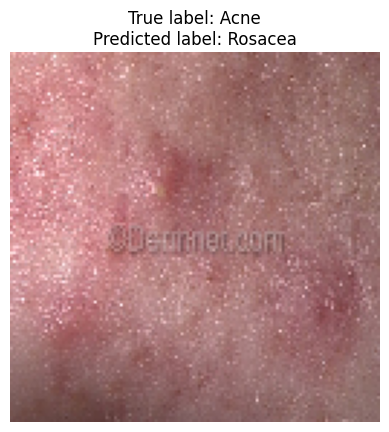

1/1 [==============================] - 0s 39ms/step


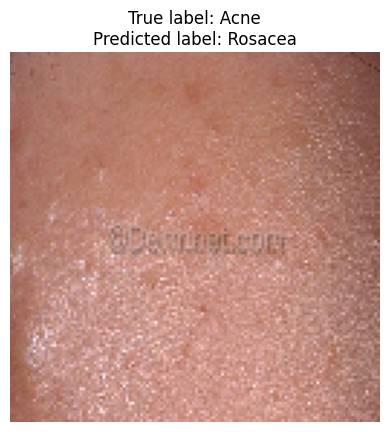

1/1 [==============================] - 0s 43ms/step


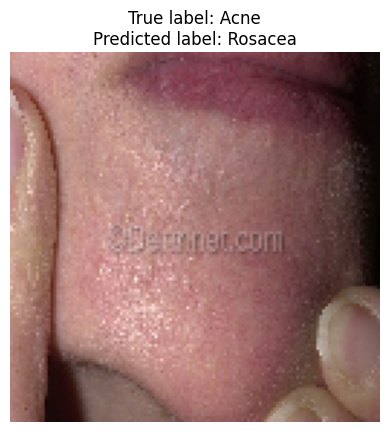

1/1 [==============================] - 0s 40ms/step


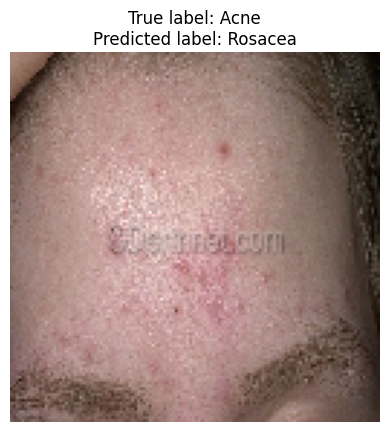

1/1 [==============================] - 0s 45ms/step


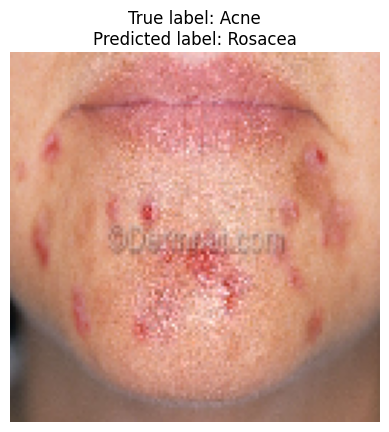

1/1 [==============================] - 0s 41ms/step


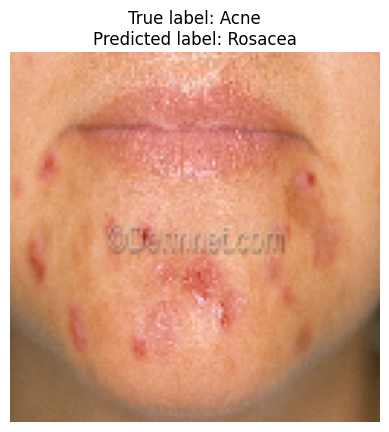

1/1 [==============================] - 0s 42ms/step


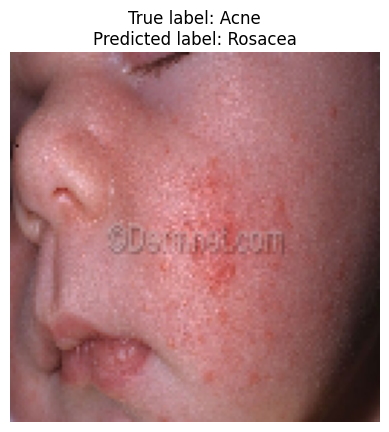

1/1 [==============================] - 0s 43ms/step


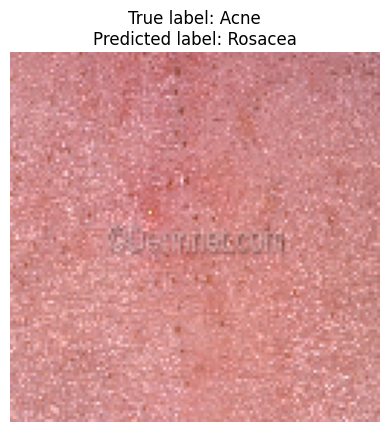

1/1 [==============================] - 0s 46ms/step


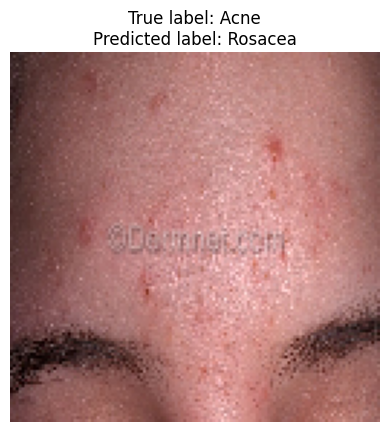

1/1 [==============================] - 0s 40ms/step


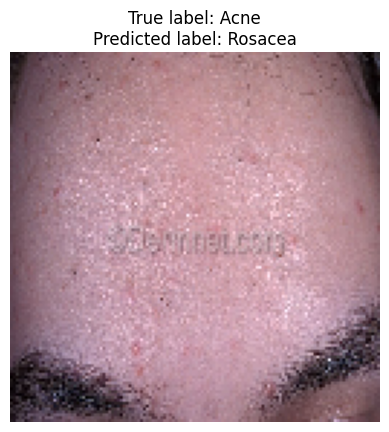

1/1 [==============================] - 0s 48ms/step


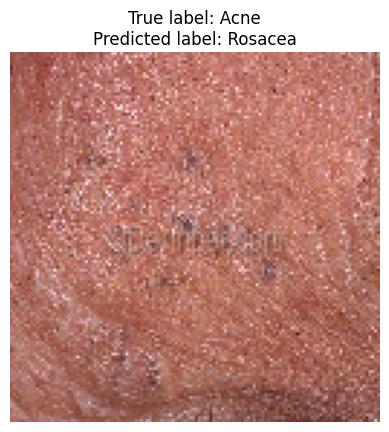

1/1 [==============================] - 0s 38ms/step


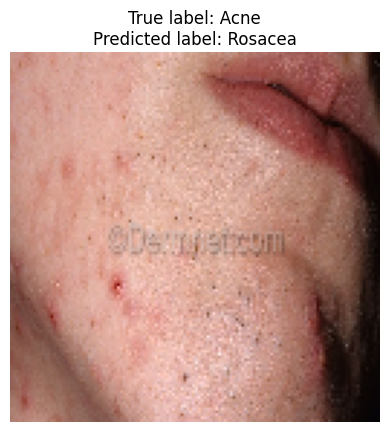

1/1 [==============================] - 0s 47ms/step


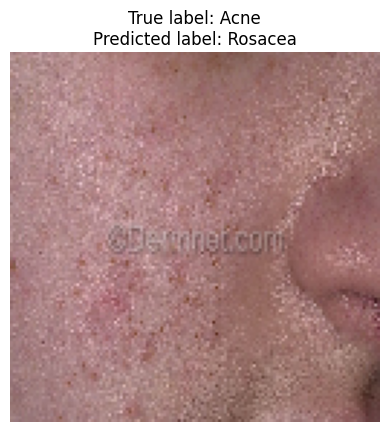

1/1 [==============================] - 0s 41ms/step


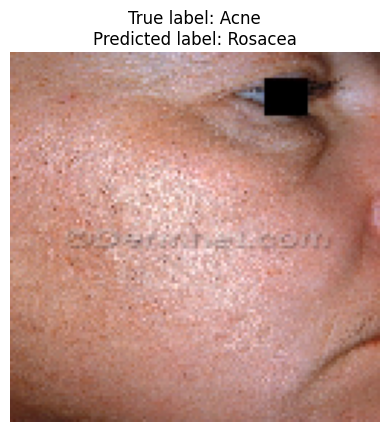

1/1 [==============================] - 0s 41ms/step


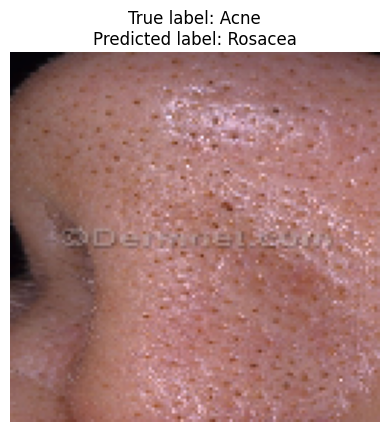

1/1 [==============================] - 0s 56ms/step


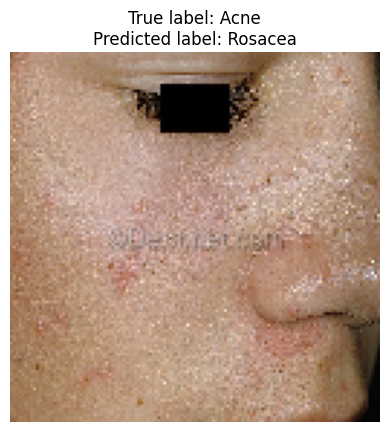

1/1 [==============================] - 0s 41ms/step


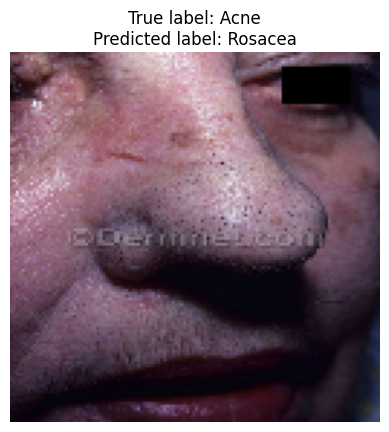

1/1 [==============================] - 0s 49ms/step


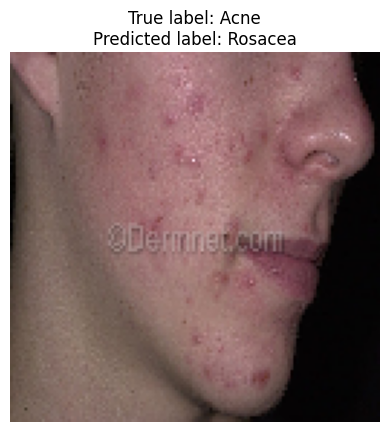

1/1 [==============================] - 0s 41ms/step


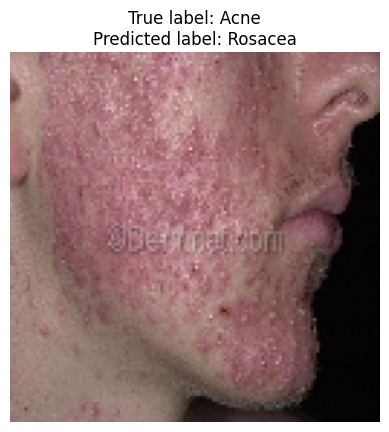

1/1 [==============================] - 0s 51ms/step


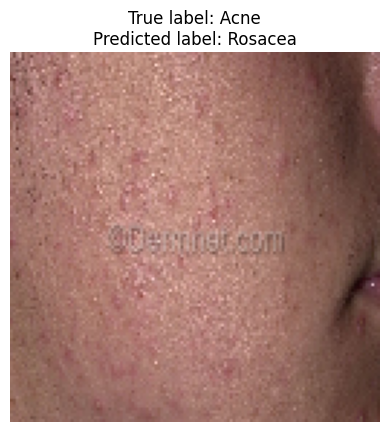

1/1 [==============================] - 0s 41ms/step


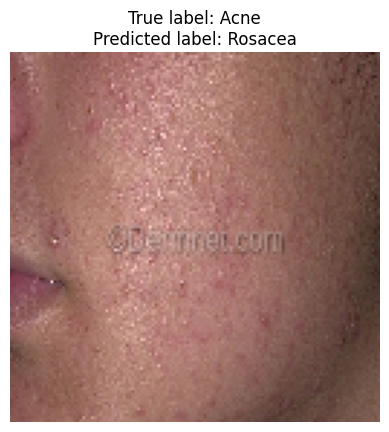

1/1 [==============================] - 0s 54ms/step


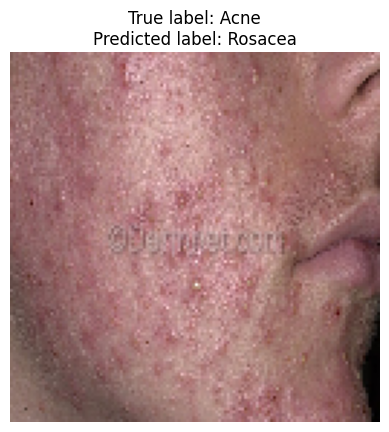

1/1 [==============================] - 0s 45ms/step


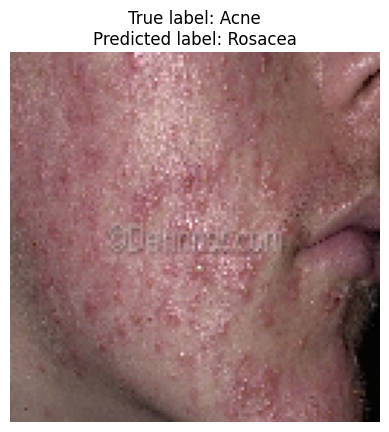

1/1 [==============================] - 0s 41ms/step


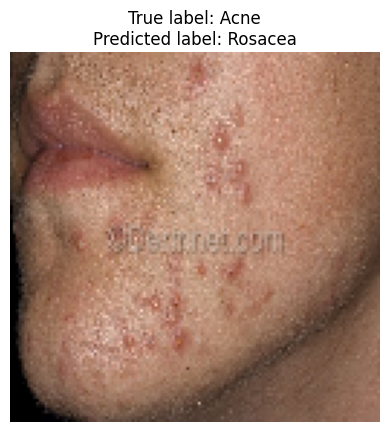

1/1 [==============================] - 0s 44ms/step


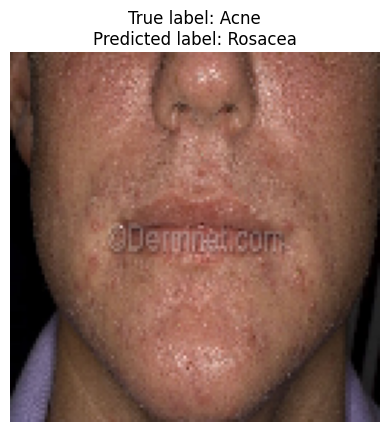

1/1 [==============================] - 0s 42ms/step


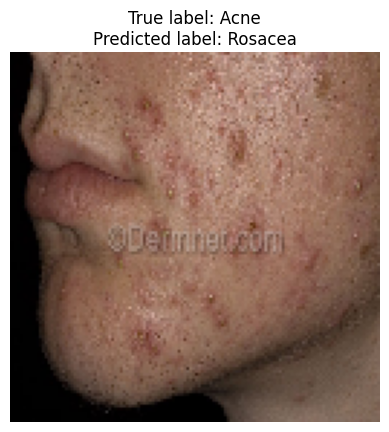

1/1 [==============================] - 0s 42ms/step


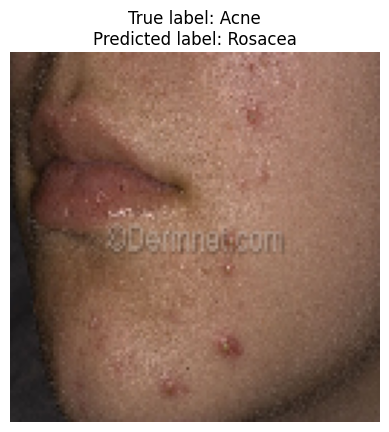

1/1 [==============================] - 0s 41ms/step


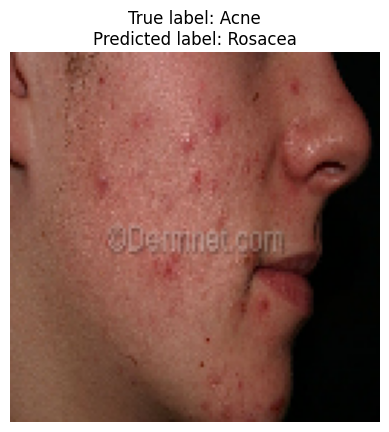

1/1 [==============================] - 0s 42ms/step


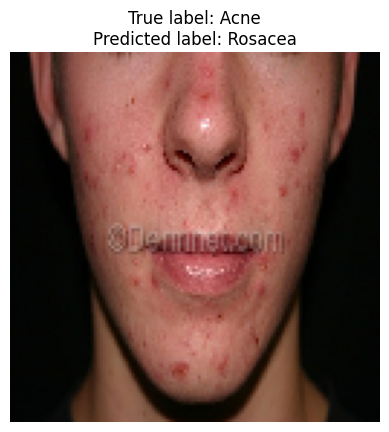

1/1 [==============================] - 0s 47ms/step


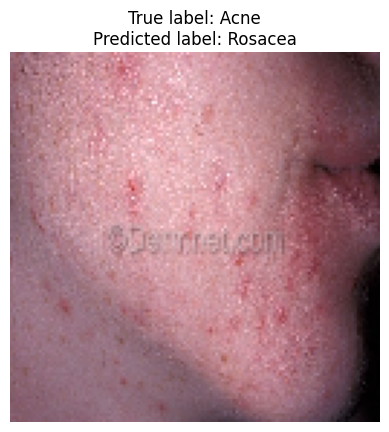

1/1 [==============================] - 0s 40ms/step


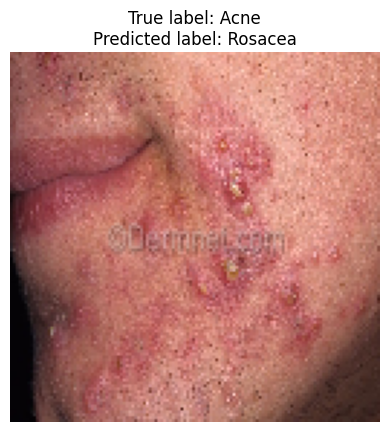

1/1 [==============================] - 0s 43ms/step


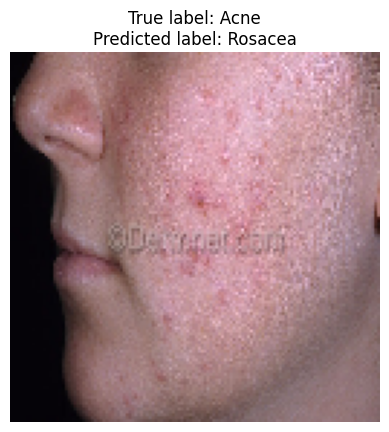

1/1 [==============================] - 0s 38ms/step


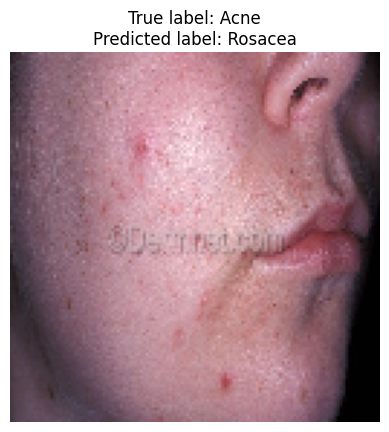

1/1 [==============================] - 0s 45ms/step


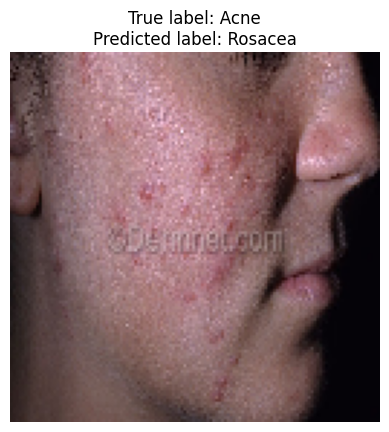

1/1 [==============================] - 0s 41ms/step


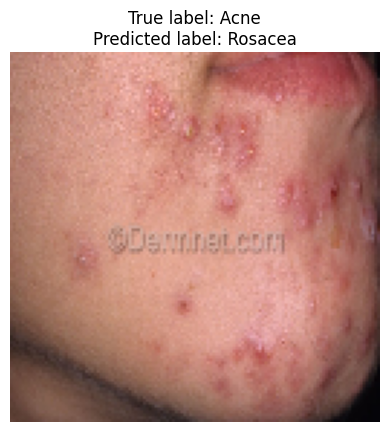

In [79]:
import os

# Path folder gambar
folder_path = 'tensorflow_datasets/DATA/Sample test/Acne'
# Map index to class name
class_names = os.listdir(test_dir)

# Loop melalui setiap file gambar dalam folder
for file_name in os.listdir(folder_path):
    # Path file gambar
    img_path = os.path.join(folder_path, file_name)
    # Load image
    img = load_img(img_path, target_size=(128, 128))
    imgplot = plt.imshow(img)
    true_label = class_names[0]
    img_array = img_to_array(img)
    batch_img = np.expand_dims(img_array, axis=0)
    # Make prediction
    prediction = model_augmented2.predict(batch_img)
    # Get the predicted class index
    predicted_class_index = prediction.argmax(axis=-1)[0]
    predicted_class_name = class_names[predicted_class_index]

    # Plot image with true and predicted labels
    plt.imshow(img_array.astype(np.uint8))
    plt.title(f'True label: {true_label}\nPredicted label: {predicted_class_name}')
    plt.axis('off')
    plt.show()

SPLIT DATA 85:15

In [33]:
# Daftar nama kelas (nama folder)
class_names = os.listdir(train_dir)

# Membuat direktori untuk data latih dan data validasi
training_dir = 'path/to/train_directory85'
validation_dir = 'path/to/valid_directory15'
os.makedirs(training_dir, exist_ok=True)
os.makedirs(validation_dir, exist_ok=True)

# Pembagian data dengan rasio 75:25
for class_name in class_names:
    class_dir = os.path.join(train_dir, class_name)
    images = os.listdir(class_dir)
    random.shuffle(images)
    split_index = int(0.85 * len(images))
    
    training_images = images[:split_index]
    validation_images = images[split_index:]
    
    for image in training_images:
        src = os.path.join(class_dir, image)
        dst = os.path.join(training_dir, class_name, image)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)
        
    for image in validation_images:
        src = os.path.join(class_dir, image)
        dst = os.path.join(validation_dir, class_name, image)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)

In [34]:
# Menampilkan isi folder train
print('Isi folder train:')
for class_name in os.listdir(training_dir):
    class_dir = os.path.join(training_dir, class_name)
    print(f'Kelas: {class_name}, Jumlah gambar: {len(os.listdir(class_dir))}')

# Menampilkan isi folder validation
print('Isi folder validation:')
for class_name in os.listdir(validation_dir):
    class_dir = os.path.join(validation_dir, class_name)
    print(f'Kelas: {class_name}, Jumlah gambar: {len(os.listdir(class_dir))}')

Isi folder train:
Kelas: Acne, Jumlah gambar: 74
Kelas: Actinic Keratosis, Jumlah gambar: 74
Kelas: Basal Cell Carcinoma, Jumlah gambar: 74
Kelas: Eczemaa, Jumlah gambar: 74
Kelas: Rosacea, Jumlah gambar: 74
Isi folder validation:
Kelas: Acne, Jumlah gambar: 14
Kelas: Actinic Keratosis, Jumlah gambar: 14
Kelas: Basal Cell Carcinoma, Jumlah gambar: 14
Kelas: Eczemaa, Jumlah gambar: 14
Kelas: Rosacea, Jumlah gambar: 14


In [35]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Definisikan objek ImageDataGenerator untuk normalisasi gambar
datagen_augmented = ImageDataGenerator(rescale=1.0/255.0,
                            rotation_range=40,  # Rentang rotasi antara -20 hingga +20 derajat
                            width_shift_range=0.2,  # Rentang pergeseran horizontal
                            height_shift_range=0.2,  # Rentang pergeseran vertikal
                            shear_range=0.2,  # Rentang pergeseran shear
                            zoom_range=0.2,  # Rentang perbesaran atau perkecilan
                            horizontal_flip=True,  # Flip horizontal
                            fill_mode='nearest')

# Buat dataset dari direktori menggunakan ImageDataGenerator
train_augmented_generator = datagen_augmented.flow_from_directory(
    training_dir,
    target_size=(128, 128),
    batch_size=32,
    class_mode='categorical',  # Klasifikasi multiclass
    shuffle=True
)
valid_augmented_generator = datagen_augmented.flow_from_directory(
    validation_dir,
    target_size=(128, 128),
    batch_size=32,
    class_mode='categorical',  # Klasifikasi multiclass
    shuffle=True
)

Found 370 images belonging to 5 classes.
Found 70 images belonging to 5 classes.


In [36]:
# def create_model():
#     model = Sequential([
#     Conv2D(32, (3,3), 1, activation="relu", input_shape = (128, 128, 3)),
#     MaxPooling2D((2,2)),

#     Conv2D(16, (3,3), 1, activation="relu"),
#     MaxPooling2D((2,2)),
    
#     Conv2D(8, (3,3), 1, activation="relu"),
#     MaxPooling2D((2,2)),
    
#     Flatten(),
#     Dense(512, activation='relu'),
#     Dense(256, activation='relu'),
#     Dense(128, activation='relu'),
#     Dense(5, activation='softmax'),
# ])
#     model.compile(
#     loss='categorical_crossentropy',
#     optimizer='adam',
#     metrics=['accuracy']
# )
#     return model

In [37]:
# model = create_model()
model_augmented3 = create_model()

In [38]:
model_augmented3.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 28, 28, 128)       73856     
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 14, 14, 128)     

In [39]:
# dengan augmentasi
history_augmented = model_augmented3.fit(
    train_augmented_generator,
    validation_data=(valid_augmented_generator),
    epochs=20,
    batch_size=32,
    steps_per_epoch=len(train_augmented_generator),
    validation_steps=len(valid_augmented_generator)
)

Epoch 1/20
12/12 [==============================] - 17s 1s/step - loss: 1.6524 - accuracy: 0.2108 - val_loss: 1.6081 - val_accuracy: 0.2000
Epoch 2/20
12/12 [==============================] - 13s 1s/step - loss: 1.6140 - accuracy: 0.2000 - val_loss: 1.6057 - val_accuracy: 0.2000
Epoch 3/20
12/12 [==============================] - 13s 1s/step - loss: 1.6048 - accuracy: 0.2108 - val_loss: 1.6063 - val_accuracy: 0.2000
Epoch 4/20
12/12 [==============================] - 13s 1s/step - loss: 1.6106 - accuracy: 0.2054 - val_loss: 1.5967 - val_accuracy: 0.2000
Epoch 5/20
12/12 [==============================] - 12s 1s/step - loss: 1.6031 - accuracy: 0.2027 - val_loss: 1.5544 - val_accuracy: 0.2000
Epoch 6/20
12/12 [==============================] - 12s 1s/step - loss: 1.5781 - accuracy: 0.2243 - val_loss: 1.4949 - val_accuracy: 0.2857
Epoch 7/20
12/12 [==============================] - 12s 1s/step - loss: 1.5413 - accuracy: 0.2649 - val_loss: 1.4846 - val_accuracy: 0.3429
Epoch 8/20
12/12 [==

In [40]:
model_augmented3.evaluate(test_augmented_generator)

6/6 [==============================] - 2s 377ms/step - loss: 1.5487 - accuracy: 0.2919


[1.5486540794372559, 0.2918919026851654]

In [41]:
# Memperoleh data untuk plot
# train_acc = history.history['accuracy']
# val_acc = history.history['val_accuracy']
# train_loss = history.history['loss']
# val_loss = history.history['val_loss']

train_acc_augmented = history_augmented.history['accuracy']
val_acc_augmented = history_augmented.history['val_accuracy']
train_loss_augmented = history_augmented.history['loss']
val_loss_augmented = history_augmented.history['val_loss']

epochs = range(1, len(train_acc_augmented)+1)

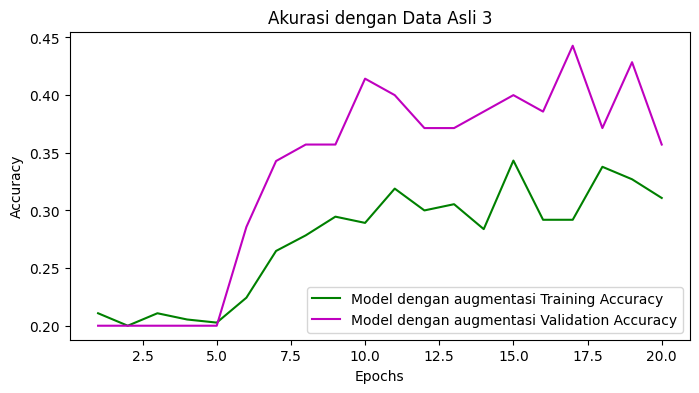

In [42]:
# # Melakukan plotting untuk akurasi Model 1
# plt.figure(figsize=(8, 4))
# plt.plot(epochs, train_acc, 'r', label='Model tanpa augmentasi Training Accuracy')
# plt.plot(epochs, val_acc, 'b', label='Model tanpa augmentasi Validation Accuracy')
# plt.title('Model tanpa augmentasi Training and Validation Accuracy')
# plt.xlabel('Epochs')
# plt.ylabel('Accuracy')
# plt.legend()
# plt.show()

# Melakukan plotting untuk akurasi Model 2
plt.figure(figsize=(8, 4))
plt.plot(epochs, train_acc_augmented, 'g', label='Model dengan augmentasi Training Accuracy')
plt.plot(epochs, val_acc_augmented, 'm', label='Model dengan augmentasi Validation Accuracy')
plt.title('Akurasi dengan Data Asli 3')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

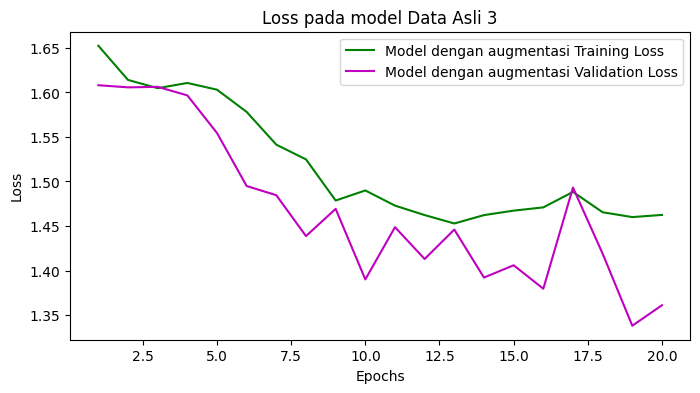

In [43]:
# Melakukan plotting untuk akurasi Model 1
# plt.figure(figsize=(8, 4))
# plt.plot(epochs, train_loss, 'r', label='Model tanpa augmentasi Training Loss')
# plt.plot(epochs, val_loss, 'b', label='Model tanpa augmentasi Validation Loss')
# plt.title('Model tanpa augmentasi Training and Validation Accuracy')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

# Melakukan plotting untuk akurasi Model 2
plt.figure(figsize=(8, 4))
plt.plot(epochs, train_loss_augmented, 'g', label='Model dengan augmentasi Training Loss')
plt.plot(epochs, val_loss_augmented, 'm', label='Model dengan augmentasi Validation Loss')
plt.title('Loss pada model Data Asli 3')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [44]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

classs = ['Acne', 'Actinic Keratosis', 'Basal Cell Carcinoma', 'Eczema', 'Rosacea']

# Prediksi pada data validation
predictions = model_augmented3.predict(test_augmented_generator)

# Label sebenarnya dari generator
target = test_augmented_generator.labels

# Mengubah hasil prediksi menjadi bentuk kelas
predicted_classes = np.argmax(predictions, axis=1)

# Menghitung metrik individual
accuracy = accuracy_score(target, predicted_classes)
precision = precision_score(target, predicted_classes, average='macro')
recall = recall_score(target, predicted_classes, average='macro')
f1 = f1_score(target, predicted_classes, average='macro')

# Menampilkan metrik
print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1-score: {f1}')

6/6 [==============================] - 3s 382ms/step
Accuracy: 0.1837837837837838
Precision: 0.10795426298782003
Recall: 0.18378378378378377
F1-score: 0.10076737934483622


c:\users\yusuf\appdata\local\programs\python\python38\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


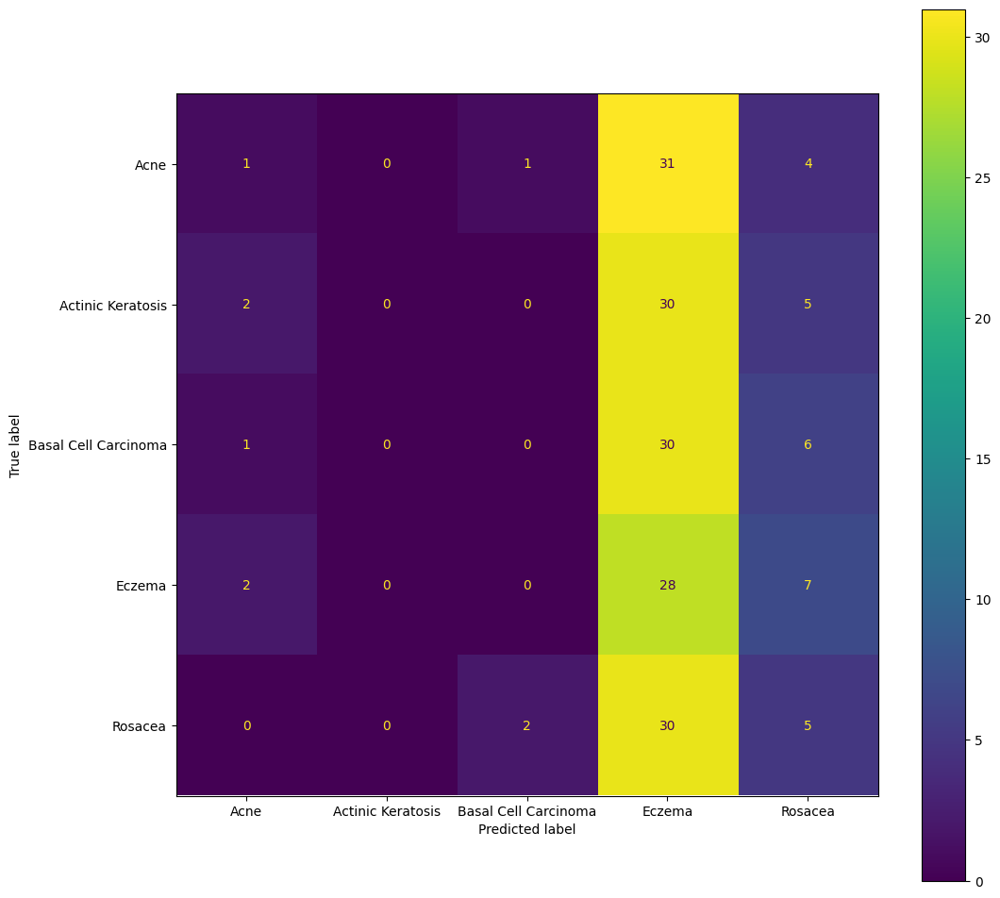

In [45]:
from sklearn.metrics import ConfusionMatrixDisplay

fig, ax = plt.subplots(figsize=(12,12))
ConfusionMatrixDisplay.from_predictions(target, predicted_classes,ax=ax ,display_labels = classs)
plt.show()

1/1 [==============================] - 0s 181ms/step


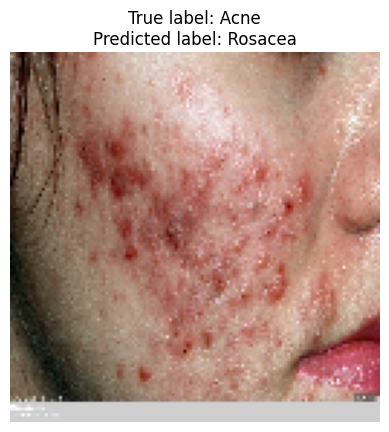

1/1 [==============================] - 0s 47ms/step


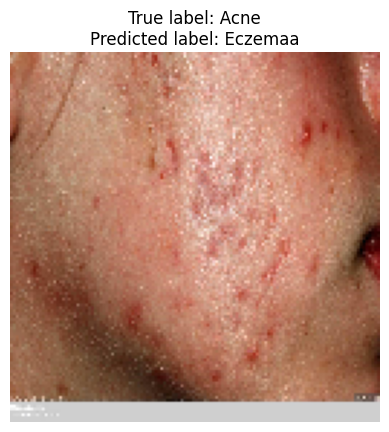

1/1 [==============================] - 0s 53ms/step


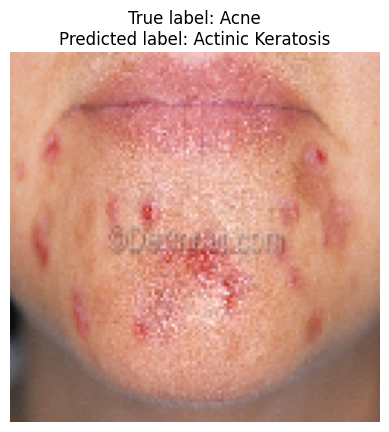

1/1 [==============================] - 0s 66ms/step


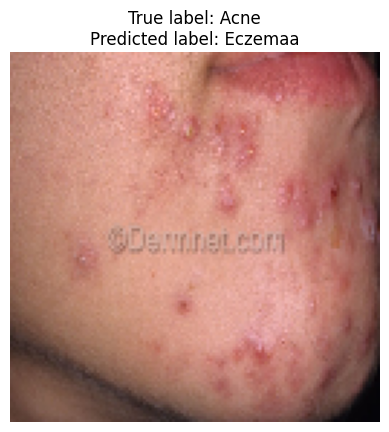

1/1 [==============================] - 0s 58ms/step


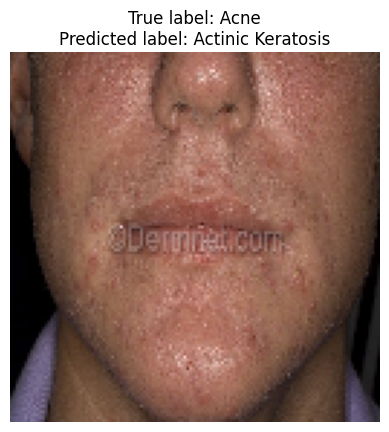

In [46]:
# Path folder gambar
folder_path = 'tensorflow_datasets/DATA/Sample test/Acne'
# Map index to class name
class_names = os.listdir(test_dir)

# Loop melalui setiap file gambar dalam folder
for file_name in os.listdir(folder_path):
    # Path file gambar
    img_path = os.path.join(folder_path, file_name)
    # Load image
    img = load_img(img_path, target_size=(128, 128))
    imgplot = plt.imshow(img)
    true_label = class_names[0]
    img_array = img_to_array(img)
    batch_img = np.expand_dims(img_array, axis=0)
    # Make prediction
    prediction = model_augmented3.predict(batch_img)
    # Get the predicted class index
    predicted_class_index = prediction.argmax(axis=-1)[0]
    predicted_class_name = class_names[predicted_class_index]

    # Plot image with true and predicted labels
    plt.imshow(img_array.astype(np.uint8))
    plt.title(f'True label: {true_label}\nPredicted label: {predicted_class_name}')
    plt.axis('off')
    plt.show()

In [47]:
# model.save('DA_tanpa_augmentasi.h5')

In [64]:
model_augmented.save('DA_dengan_augmentasi.h5')

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model_augmented)
tflite_model = converter.convert()

with open("model_DA1.tflite", "wb") as f:
    f.write(tflite_model)